In [1]:
%load_ext autoreload
%autoreload 2
from dpe import DPE
from lib_data import *
import matplotlib.pyplot as plt
import numpy as np
from lib_nn_dpe import NN_dpe
from IPython import display

import serial
%config InlineBackend.figure_formats = ['svg']

import matplotlib
matplotlib.rcParams['font.sans-serif'] = "Arial"

In [2]:
dpe = DPE('COM6')
dpe.set_clock(50)
dpe.shape

DAC initialized to a span from -10 V to 10 V
Setting vrefs to default
Setting ADC_CK freq=50000.0kHz
Setting CK_ARRAY freq=50000.0kHz


[64, 64]

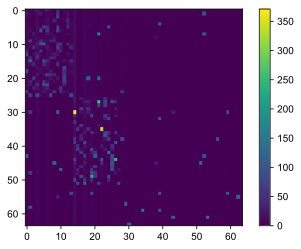

In [10]:
g = dpe.read(1, Vread=0.15,Tdly=500, method='fast')
plt.imshow(g * 1e6)
plt.colorbar()

....

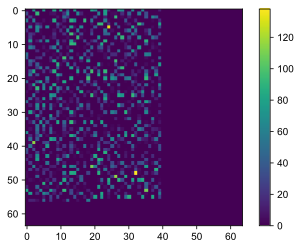

In [14]:
g = dpe.read(0,Tdly=1000, method='slow')
plt.imshow(g * 1e6)
plt.colorbar()

....

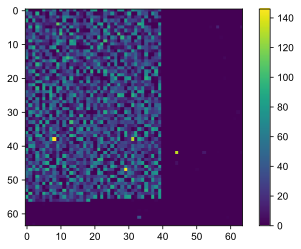

In [15]:
g = dpe.read(2,Tdly=1000, method='slow')
plt.imshow(g * 1e6)
plt.colorbar()

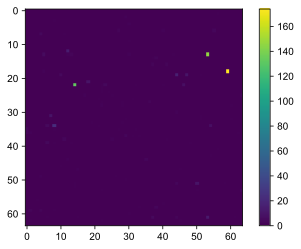

In [5]:
g = dpe.read(1, Tdly=500, method='fast')
plt.imshow(g * 1e6)
plt.colorbar()

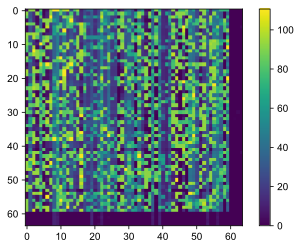

In [51]:
g = dpe.read(2, Tdly=1000, method='fast')
plt.imshow(g * 1e6)
plt.colorbar()

In [76]:
ser = serial.Serial('COM6', 9600, timeout=1)
dut.connect(ser)

In [77]:
dut.reset_chip()
dut.reset_dpe()
dut.ground_PIC()
dut.power_on()

DAC initialized to a span from -10 V to 10 V
Setting vrefs to default


In [55]:
import dut_func as dut
import serial
import time
import struct
import numpy as np
# from bitarray import bitarray
from bitstring import BitArray
import matplotlib.pyplot as plt
# %config InlineBackend.figure_formats = ['svg']
import dut_a0 as a0

from misc import *

# dut.drv.serUSB = 'COM19'
drv = dut.drv

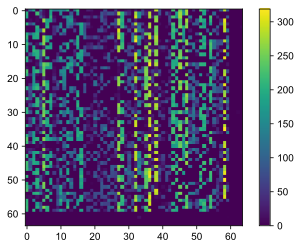

In [57]:
arr = 2
numRows = 64
numCols = 64
vRead = 0.2
vReadGate = 5.0
Vgate = 5.0
Gmap2 = np.zeros((numRows, numCols))
for rr in range(numRows):
        for cc in range(numCols):
            Gmap2[rr,cc] = 1e6*a0.pic_read_single(arr, rr, cc, gain=-1) / vRead
plt.imshow(Gmap2)
plt.colorbar()

....

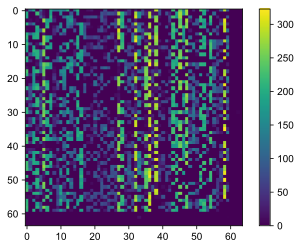

In [78]:
gslow = a0.pic_read_batch(2, Vread=0.2, gain=-1, Tdly=1000) / vRead
plt.imshow(gslow*1e6)
plt.colorbar()

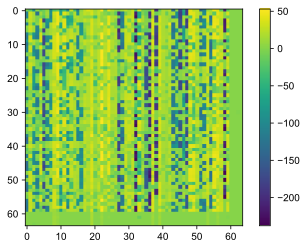

In [80]:
input = [0x1<<i for i in range(64)]
gfast = a0.pic_dpe_batch(2, input, gain=-1, Vread=0.2, Tdly=1000) / vRead
plt.imshow((gfast-gslow)*1e6)
plt.colorbar()

In [213]:
dut.disconnect()

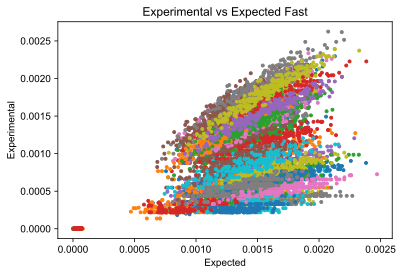

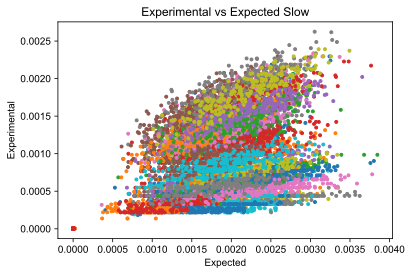

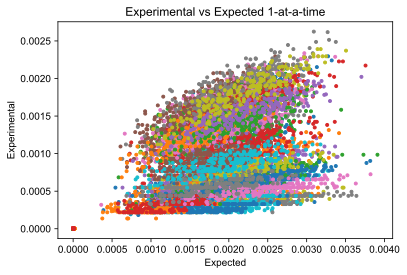

In [73]:
# Try to determine which of the array reads is more representative of what VMM operations do

arr = 2
dpe.N_BIT = 1

numTests = 100
appliedVector1 = np.zeros((64,numTests))
appliedVector2 = np.zeros((64,numTests))
randomVector = np.random.randint(2, size=(64,numTests))

appliedVector1[0:64,:] = randomVector[:,:]
appliedVector2[0:64,:] = 1-randomVector[:,:]

output1 = np.zeros((numTests,64))
output2 = np.zeros((numTests,64))
# for c in range(64):
#     output1[:,c]  = dpe.multiply(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
#     output2[:,c]  = dpe.multiply(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
output1  = dpe.multiply(arr, appliedVector1, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
output2  = dpe.multiply(arr, appliedVector2, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
all_output = np.concatenate((output1, output2))

expectedFastOutput1 = (gfast @ appliedVector1[0:64,:]).T 
expectedFastOutput2 = (gfast @ appliedVector2[0:64,:]).T 
all_expectedFast = np.concatenate((expectedFastOutput1, expectedFastOutput2))

expectedSlowOutput1 = (gslow @ appliedVector1[0:64,:]).T 
expectedSlowOutput2 = (gslow @ appliedVector2[0:64,:]).T 
all_expectedSlow = np.concatenate((expectedSlowOutput1, expectedSlowOutput2))

expected1AtATimeOutput1 = (Gmap2*1e-6 @ appliedVector1[0:64,:]).T 
expected1AtATimeOutput2 = (Gmap2*1e-6 @ appliedVector2[0:64,:]).T 
all_expected1AtATime= np.concatenate((expected1AtATimeOutput1, expected1AtATimeOutput2))

#error = output_corr - all_SW_output
fig, ax = plt.subplots()
plt.title('Experimental vs Expected Fast')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedFast[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected Slow')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedSlow[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')

#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected 1-at-a-time')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expected1AtATime[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

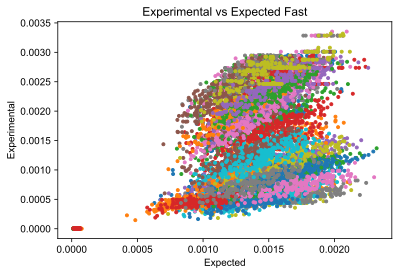

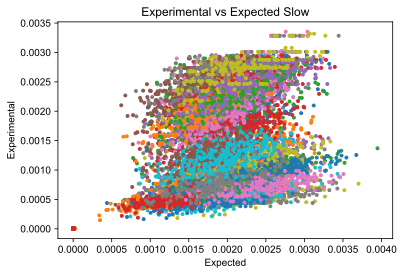

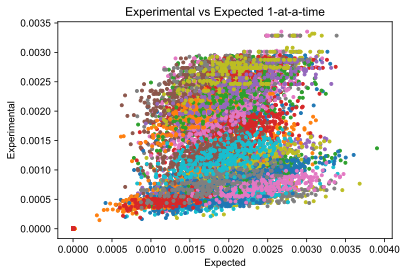

In [83]:
# Try to determine which of the array reads is more representative of what VMM operations do

arr = 2
dpe.N_BIT = 1

numTests = 100
appliedVector1 = np.zeros((64,numTests))
appliedVector2 = np.zeros((64,numTests))
randomVector = np.random.randint(2, size=(64,numTests))

appliedVector1[0:64,:] = randomVector[:,:]
appliedVector2[0:64,:] = 1-randomVector[:,:]

output1 = np.zeros((numTests,64))
output2 = np.zeros((numTests,64))
for c in range(64):
    output1[:,c]  = dpe.multiply(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
    output2[:,c]  = dpe.multiply(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, Tdly=1000).T
#output1  = dpe.multiply(arr, appliedVector1, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
#output2  = dpe.multiply(arr, appliedVector2, c_sel=[0,64], mode=1, debug=False, Tdly=1000)
all_output = np.concatenate((output1, output2))

expectedFastOutput1 = (gfast @ appliedVector1[0:64,:]).T 
expectedFastOutput2 = (gfast @ appliedVector2[0:64,:]).T 
all_expectedFast = np.concatenate((expectedFastOutput1, expectedFastOutput2))

expectedSlowOutput1 = (gslow @ appliedVector1[0:64,:]).T 
expectedSlowOutput2 = (gslow @ appliedVector2[0:64,:]).T 
all_expectedSlow = np.concatenate((expectedSlowOutput1, expectedSlowOutput2))

expected1AtATimeOutput1 = (Gmap2*1e-6 @ appliedVector1[0:64,:]).T 
expected1AtATimeOutput2 = (Gmap2*1e-6 @ appliedVector2[0:64,:]).T 
all_expected1AtATime= np.concatenate((expected1AtATimeOutput1, expected1AtATimeOutput2))

#error = output_corr - all_SW_output
fig, ax = plt.subplots()
plt.title('Experimental vs Expected Fast')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedFast[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected Slow')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expectedSlow[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')

#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
plt.title('Experimental vs Expected 1-at-a-time')
plt.xlabel('Expected')
plt.ylabel('Experimental')
for c in range(64):
    x = all_expected1AtATime[:,c]
    y = all_output[:,c]    
    ax.plot(x,y,'.')
#zz = np.linspace(0,30,30)  
#ax.plot(zz,zz,'-')

Start programming, step=0, maxBound=0 yield= 0.00% - 0.00%
1.0 devices to be programmed...reset 1.0, set 0.0
Setting 0 devices...
Programming with external timing Twidth=10.000 us
Resetting 1 devices...
Programming with external timing Twidth=100.000 us
......------------------------------
Programming completed.


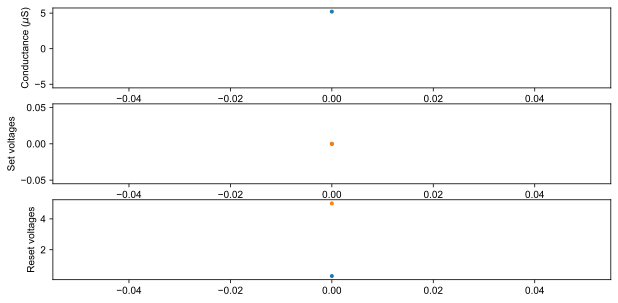

In [111]:
# Program the Hopfield Matrix in Array2, start with one device at a time
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[6,56] = 0
CMat[56,6] = 0

GMax = 100e-6
targetG = np.zeros((64,64))
targetG[0:60,0:60] = CMat*GMax


import dut_func as dut
import time
import struct
import matplotlib
import matplotlib.pyplot as plt

from dpe import DPE
from lib_data import *
from lib_nn_dpe import NN_dpe
from IPython import display
from lib_tune_g import *

arr = 2
row = 6
col = 56
dpe.N_BIT = 1
vSetRamp = [0.2, 2.6, 0.1]
vGateSetRamp = [0.3, 1.4, 0.1]
vResetRamp = [0.3, 2.5, 0.1]
vGateResetRamp = [5.0, 5.5, 0.5]
TwidthSet=10e-6
TwidthReset=100e-6
Gtol=5e-6

Msel =np.zeros((64,64))
Msel[row,col]=1


data1 = dpe.tune_conductance_old(arr, targetG, saveHistory=True, maxSteps=300, maxRetry=2, method='slow', vSetRamp = vSetRamp, 
                                     vGateSetRamp = vGateSetRamp, vResetRamp = vResetRamp, vGateResetRamp = vGateResetRamp, TwidthSet=TwidthSet, 
                                     TwidthReset=TwidthReset, Gtol=Gtol, Msel=Msel, numReads=3)

plot_history(row, col, data1)

Start programming, step=999, maxBound=1 yield= 84.35% - 84.35%
640.0 devices to be programmed...reset 14.0, set 627.0
Setting 626 devices...
Programming with external timing Twidth=10.000 us
Resetting 14 devices...
Programming with external timing Twidth=100.000 us


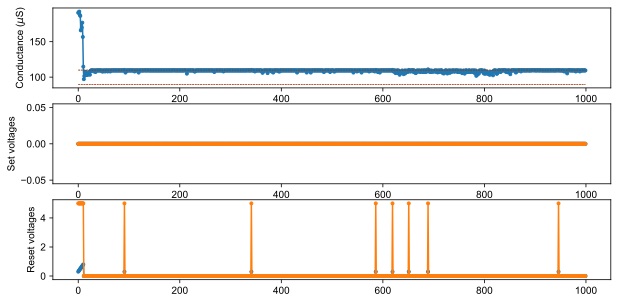

In [84]:
# Program the Hopfield Matrix in Array2 - full array
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[6,56] = 0
CMat[56,6] = 0

GMax = 100e-6
targetG = np.zeros((64,64))
targetG[0:60,0:60] = CMat*GMax


import dut_func as dut
import time
import struct
import matplotlib
import matplotlib.pyplot as plt

from dpe import DPE
from lib_data import *
from lib_nn_dpe import NN_dpe
from IPython import display
from lib_tune_g import *

arr = 2
row = 1
col = 0
dpe.N_BIT = 1
vSetRamp = [0.2, 2.8, 0.1]
vGateSetRamp = [0.3, 1.9, 0.05]
vResetRamp = [0.3, 2.9, 0.05]
vGateResetRamp = [5.0, 5.5, 0.5]
TwidthSet=10e-6
TwidthReset=100e-6
Gtol=5e-6

Msel =np.ones((64,64))



data1 = dpe.tune_conductance_old(arr, targetG, saveHistory=True, maxSteps=1000, maxRetry=2, method='slow', vSetRamp = vSetRamp, 
                                     vGateSetRamp = vGateSetRamp, vResetRamp = vResetRamp, vGateResetRamp = vGateResetRamp, TwidthSet=TwidthSet, 
                                     TwidthReset=TwidthReset, Gtol=Gtol, Msel=Msel, numReads=3)

plot_history(row, col, data1)

..

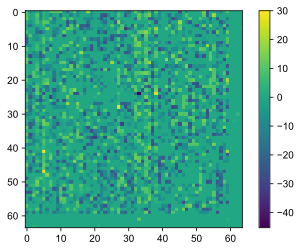

In [3]:
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[6,56] = 0
CMat[56,6] = 0

GMax = 100e-6
targetG = np.zeros((64,64))
targetG[0:60,0:60] = CMat*GMax


g = dpe.read(2, Tdly=500, method='slow')

plt.imshow((g-targetG)*1e6)
plt.colorbar()


5.542521994134897
0.0


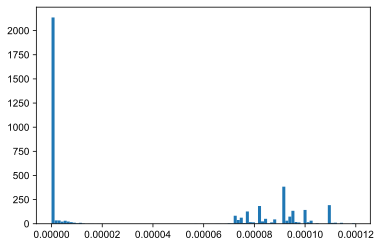

In [132]:
print(g[6,56]*1e6)
targetG[6,56]=0
print(targetG[6,56]*1e6)

ax.hist(g.flatten(),bins=100);

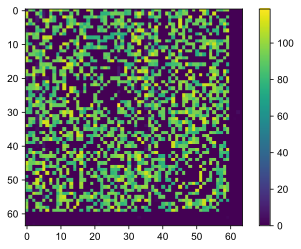

In [87]:
plt.imshow((g)*1e6)
plt.colorbar()

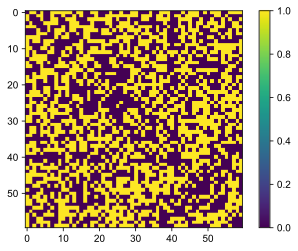

In [17]:
# Program the Hopfield Matrix in Array2, start with one device at a time
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[6,56] = 0
CMat[56,6] = 0
plt.imshow(CMat)
plt.colorbar()

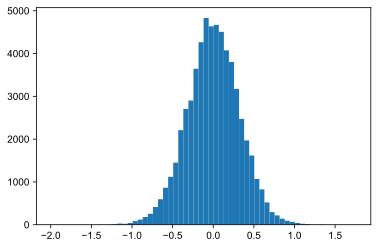

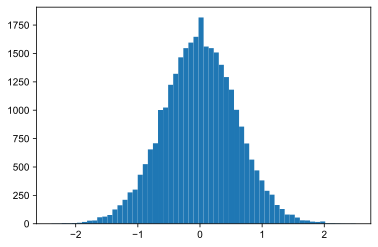

In [4]:
# NOW TRY TAKING THE DATA ONLY ONE COLUMN AT A TIME TO SEE IF WE GET BETTER ACCURACY. Linear corrections
from lib_data import *
import scipy.io as sio
mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[6,56] = 0
CMat[56,6] = 0

import dut_func as dut
import time
import struct
import matplotlib
import matplotlib.pyplot as plt

from dpe import DPE
from lib_data import *
from lib_nn_dpe import NN_dpe
from IPython import display

arr = 2
dpe.N_BIT = 1

numTests = 500
appliedVector1 = np.zeros((64,numTests))
appliedVector2 = np.zeros((64,numTests))
randomVector = np.random.randint(2, size=(60,numTests))

appliedVector1[0:60,:] = randomVector[:,:]
appliedVector2[0:60,:] = 1-randomVector[:,:]
neuronVector = appliedVector1[0:60,:] - appliedVector2[0:60,:]

output1 = np.zeros((numTests,60))
output2 = np.zeros((numTests,60))
for c in range(60):
    #output1[:,c]  = dpe.multiply_w_delay(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, delay=5).T
    output1[:,c]  = dpe.multiply(arr, appliedVector1, c_sel=[c,c+1], mode=1, debug=False, Tdly=500).T
    #output2[:,c]  = dpe.multiply_w_delay(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, delay=5).T
    output2[:,c]  = dpe.multiply(arr, appliedVector2, c_sel=[c,c+1], mode=1, debug=False, Tdly=500).T
all_output = np.concatenate((output1, output2))

#SW_output = neuronVector * CMat
#SW_neuron = np.matmul(neuronVector, CMat)
SW_output1 = (CMat.T @ appliedVector1[0:60,:]).T 
SW_output2 = (CMat.T @ appliedVector2[0:60,:]).T 
all_SW_output = np.concatenate((SW_output1, SW_output2))

lin_corrs = []
for c in range(60):
    lin_corrs.append( np.polyfit(all_output[:,c], all_SW_output[:,c], 1))

output_corr  = dpe.lin_corr(all_output, lin_corrs)
output_corr1 = dpe.lin_corr(output1, lin_corrs)
output_corr2 = dpe.lin_corr(output2, lin_corrs)
exp_neuron_output = output_corr1 - output_corr2
SW_neuron_output = SW_output1 - SW_output2

error = output_corr - all_SW_output
fig, ax = plt.subplots()
for c in range(60):
    x = all_SW_output[:,c]
    y = output_corr[:,c]    
    ax.plot(x,y,'.')
zz = np.linspace(0,30,30)  
ax.plot(zz,zz,'-')

fig, ax = plt.subplots()
ax.hist(error.flatten(),bins=60);

fig, ax = plt.subplots()
for c in range(60):
    x = SW_neuron_output[:,c]
    y = exp_neuron_output[:,c]    
    ax.plot(x,y,'.')   
zz = np.linspace(-25,25,50)    
ax.plot(zz,zz,'-')  

fig, ax = plt.subplots()
err_neuron = exp_neuron_output.flatten() - SW_neuron_output.flatten()
ax.hist(err_neuron.flatten(),bins=60);

In [37]:
#Run the Hopfield network with different Schmidt width values, but all at the same starting neuron vector
#Compare the results to perfect Software version.
arr = 2
numCycles = 10
numTrials = 10

startSchmidtVals = [-3.5,0]
endSchmidtVals   = [+0.5,0]
numSchmidt = np.size(startSchmidtVals)

SchmidtCycleVector = np.zeros((numCycles,numSchmidt))

for ss in np.arange(numSchmidt):
    SchmidtCycleVector[:,ss] = np.linspace(startSchmidtVals[ss], endSchmidtVals[ss], numCycles)
    

threshold = 0
noise = 0
numCols = 60

#energyHistory = np.zeros((numCycles*numCols+1, numTrials))
appliedVector1 = np.zeros((64,numSchmidt))
appliedVector2 = np.zeros((64,numSchmidt))

neuronVectorHistory = np.zeros((60,numSchmidt, numCycles*numCols+1, numTrials))
rawColumnOutput1History = np.zeros((1,numSchmidt, numCycles*numCols+1, numTrials))
rawColumnOutput2History = np.zeros((1,numSchmidt, numCycles*numCols+1, numTrials))
columnOutputConvertedHistory =  np.zeros((1,numSchmidt, numCycles*numCols+1, numTrials))
neuronVector = np.zeros((60,numSchmidt))
columnUpdateHistory = np.zeros((1,numCycles*numCols+1, numTrials))

for tt in np.arange(numTrials):
    print('Trial number', tt)
    randomVector = np.random.randint(2, size=(60,1))
    initVector = randomVector

    for ss in np.arange(numSchmidt):
        appliedVector1[0:60,ss] = initVector[:,0]
        appliedVector2[0:60,ss] = 1-initVector[:,0]
        neuronVector[0:60,ss] = appliedVector1[0:60,ss] - appliedVector2[0:60,ss]
        neuronVectorHistory[:,ss,0,tt] = appliedVector1[0:60,ss] - appliedVector2[0:60,ss]
        
    #energyHistory[0,tt]= 0.5*np.dot(neuronVector.T, (CMat @ neuronVector))            

    for cc in np.arange(numCycles):
        randOrderColumns = np.arange(60)
        np.random.shuffle(randOrderColumns)
        
        trackCol=0
        for ii in randOrderColumns:
            
            output1  = dpe.multiply(arr, appliedVector1, c_sel=[ii,ii+1], mode=1, debug=False, Tdly=500).T
            output2  = dpe.multiply(arr, appliedVector2, c_sel=[ii,ii+1], mode=1, debug=False, Tdly=500).T            
            #output1  = dpe.multiply_w_delay(arr, appliedVector1, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
            #output2  = dpe.multiply_w_delay(arr, appliedVector2, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
            
            output_corr = noise - dpe.lin_corr(output1, lin_corrs) + dpe.lin_corr(output2, lin_corrs)
            
            
            for ss in np.arange(numSchmidt):
                rawColumnOutput1History[0,ss,60*cc+trackCol+1,tt] = output1[0,ss]
                rawColumnOutput2History[0,ss,60*cc+trackCol+1,tt] = output2[0,ss]
                columnOutputConvertedHistory[0,ss,60*cc+trackCol+1,tt] = output_corr[0,ss]
                
                threshVector = threshold - SchmidtCycleVector[cc,ss]*neuronVector[ii,ss]
                #if (output_corr2[0,ii] >= threshVector[ii,0]):
                #if (output_corr >= threshVector[ii,0]):
                if (output_corr[0,ss] >= threshVector):
                    appliedVector1[ii,ss] = 1
                    appliedVector2[ii,ss] = 0
                    neuronVector[ii,ss] = 1
                else:
                    appliedVector1[ii,ss] = 0
                    appliedVector2[ii,ss] = 1
                    neuronVector[ii,ss] = -1
                neuronVectorHistory[:,ss,60*cc+trackCol+1,tt] = neuronVector[:,ss]
                
            columnUpdateHistory[0,60*cc+trackCol+1,tt] = ii                
            trackCol = trackCol + 1

save_workspace(vars(), note='Prober2_HNN_3cyc_10trial_VarSchmidt')

Trial number 0
Trial number 1
Trial number 2
Trial number 3
Trial number 4
Trial number 5
Trial number 6
Trial number 7
Trial number 8
Trial number 9
Saving In(<class 'list'>), Out(<class 'dict'>), mat_contents(<class 'dict'>), CMat(<class 'numpy.ndarray'>), GMax(<class 'float'>), targetG(<class 'numpy.ndarray'>), g(<class 'numpy.ndarray'>), arr(<class 'int'>), numTests(<class 'int'>), appliedVector1(<class 'numpy.ndarray'>), appliedVector2(<class 'numpy.ndarray'>), randomVector(<class 'numpy.ndarray'>), neuronVector(<class 'numpy.ndarray'>), output1(<class 'numpy.ndarray'>), output2(<class 'numpy.ndarray'>), c(<class 'int'>), all_output(<class 'numpy.ndarray'>), SW_output1(<class 'numpy.ndarray'>), SW_output2(<class 'numpy.ndarray'>), all_SW_output(<class 'numpy.ndarray'>), lin_corrs(<class 'list'>), output_corr(<class 'numpy.ndarray'>), output_corr1(<class 'numpy.ndarray'>), output_corr2(<class 'numpy.ndarray'>), exp_neuron_output(<class 'numpy.ndarray'>), SW_neuron_output(<class 'nu

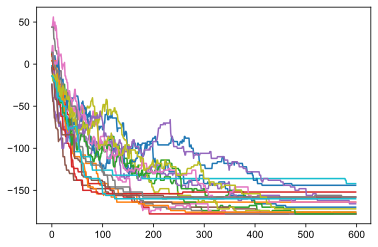

In [38]:
Ei=np.zeros((60*numCycles-1,2,numTrials));
fig, ax = plt.subplots()
for k in range (0,numTrials):
    for j in range (0,2):
        for i in range (0,60*numCycles-1):
            Ei[i,j,k]=0.5*np.dot(np.dot(np.transpose(neuronVectorHistory[0:59,j,i,k]),targetG[0:59,0:59]/1e-4),neuronVectorHistory[0:59,j,i,k])
        
        ax.plot(Ei[:,j,k])
        
    
    
        

       
           




In [97]:
fig, ax = plt.subplots()
ax.plot(Ei[:,1])
Ei[:,1].size
    

1200

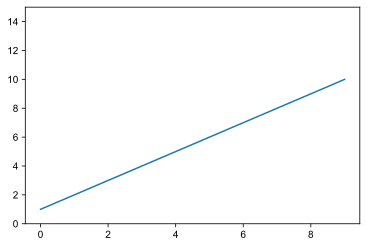

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [200]:
import matplotlib.pyplot as plt
import numpy as np
import time
a=0;
def demo(a):
    y = [xt*a+1 for xt in x]
    ax.plot(x,y)

if __name__ == '__main__':
    plt.ion()
    fig, ax = plt.subplots()
    ax.set_ylim([0,15])
    x = range(0,10)
    for a in range(1,10):
        demo(a)
        plt.pause(0.5)
        plt.draw()

In [64]:
# Run a Hopfield network with multiple trials in parallel, and plot the energy  updating in real time

import pylab as plt
import pickle
import numpy as np
from time import sleep
import matplotlib
matplotlib.use('Qt5Agg')
from lib_data import *
import scipy.io as sio

numCycles = 2
numTrials = 1

startSchmidtVal = -3.0
endSchmidtVal   = +1.4

mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[56,6] = 0
CMat[6,56] = 0

arr = 2
SchmidtCycleVector = np.linspace(startSchmidtVal, endSchmidtVal, numCycles)
threshold = 0
noise = 0
numCols = 60
appliedVector1 = np.zeros((64,numTrials))
appliedVector2 = np.zeros((64,numTrials))
neuronVectorHistory = np.zeros((60,numTrials, numCycles*numCols+1))
neuronVector = np.zeros((60,numTrials))
columnUpdateHistory = np.zeros((1,numCycles*numCols+1))
energyHistory = np.zeros((numCycles*numCols+1, numTrials))
num_updates = numCycles*numCols+1
time_vector = np.arange(0, num_updates)
color_idx_array = np.linspace(0,1.0,numTrials)

# Make the updatable Figure - this code taken from Thomas

plt.ion()
plt.rcParams['lines.linewidth'] = 2.0 #instead of 1.5
color_map = 'jet'#'cool' #try also 'prism', check here: https://matplotlib.org/examples/color/colormaps_reference.html

fig = plt.figure(0, figsize= [plt.rcParams["figure.figsize"][0]*2., plt.rcParams["figure.figsize"][1]])
ax = fig.add_subplot(121)
color_idx_array = np.linspace(0,1.0,numTrials)
ax.set_xlabel("Time", fontsize=15)
ax.set_ylabel("Energy", fontsize=15)
ax.set_xlim([time_vector[0], time_vector[-1]])
ax.set_ylim([-200, 300.])

trial_index = 0
energy_vector = np.NaN * np.zeros((num_updates,numTrials))  # NaNs such that it's not plotted

#lines = []
#for tt in np.arange(numTrials):
#    lobj = ax.plot(time_vector, energy_vector, '-', color=plt.get_cmap(color_map)(color_idx_array[tt]))[0]
#    lines.append(lobj)
        
line1, = ax.plot(time_vector, energy_vector[:,0], '-',
                 color=plt.get_cmap(color_map)(color_idx_array[trial_index]))  # Returns a tuple of line objects --> line1,
    
thisEnergy = np.zeros(2)
for tt in np.arange(numTrials):    
    randomVector = np.random.randint(2, size=(60,1))
    initVector = randomVector

    #for ss in np.arange(numSchmidt):
    appliedVector1[0:60,tt] = initVector[:,0]
    appliedVector2[0:60,tt] = 1-initVector[:,0]
    neuronVector[0:60,tt] = appliedVector1[0:60,tt] - appliedVector2[0:60,tt]
    neuronVectorHistory[:,tt,0] = appliedVector1[0:60,tt] - appliedVector2[0:60,tt]
    thisEnergy[tt] = 0.5*np.dot(neuronVector[:,tt].T, (CMat @ neuronVector[:,tt])) 
    energyHistory[0,tt]= thisEnergy[tt]
    energy_vector[0,tt] = thisEnergy[tt]

for cc in np.arange(numCycles):
    #print('Cycle number', cc)
    randOrderColumns = np.arange(60)
    np.random.shuffle(randOrderColumns)

    trackCol=0
    for ii in randOrderColumns:
        output1  = dpe.multiply_w_delay(arr, appliedVector1, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
        output2  = dpe.multiply_w_delay(arr, appliedVector2, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
        output_corr = noise - dpe.lin_corr(output1, lin_corrs) + dpe.lin_corr(output2, lin_corrs)
        for tt in np.arange(numTrials):
            threshVector = threshold - SchmidtCycleVector[cc]*neuronVector[ii,tt]
            #if (output_corr2[0,ii] >= threshVector[ii,0]):
            #if (output_corr >= threshVector[ii,0]):
            if (output_corr[tt,0] >= threshVector):
                appliedVector1[ii,tt] = 1
                appliedVector2[ii,tt] = 0
                neuronVector[ii,tt] = 1
            else:
                appliedVector1[ii,tt] = 0
                appliedVector2[ii,tt] = 1
                neuronVector[ii,tt] = -1
            neuronVectorHistory[:,tt,60*cc+trackCol+1] = neuronVector[:,tt]
            thisEnergy[tt] = 0.5*np.dot(neuronVector[:,tt].T, (CMat @ neuronVector[:,tt]))
            #thisEnergy = 0.5*np.dot(neuronVector[:,tt], np.dot(CMat, neuronVector[:,tt]))
            energyHistory[60*cc+trackCol+1,tt]= thisEnergy[tt]
            energy_vector[60*cc+trackCol+1,tt] = thisEnergy[tt]
            
            line1.set_ydata(energy_vector[:,0])  # wonder whether we can update one point at a time
            #for lnum,line in enumerate(lines):
            #    line.set_data(xlist[lnum], ylist[lnum]) # set data for each line separately. 
        
            fig.canvas.draw()
            fig.canvas.flush_events()

        columnUpdateHistory[0,60*cc+trackCol+1] = ii                
        trackCol = trackCol + 1

In [68]:
# Run a Hopfield network with multiple trials in parallel, and plot the energy  updating in real time

import pylab as plt
import pickle
import numpy as np
from time import sleep
import matplotlib
matplotlib.use('Qt5Agg')
from lib_data import *
import scipy.io as sio

numCycles = 2
numTrials = 3

startSchmidtVal = -3.0
endSchmidtVal   = +1.4

mat_contents = sio.loadmat('Exported60Node_GraphNum0.mat')
CMat = mat_contents['A']

CMat[0,33] = 0
CMat[33,0] = 0
CMat[56,6] = 0
CMat[6,56] = 0

arr = 2
SchmidtCycleVector = np.linspace(startSchmidtVal, endSchmidtVal, numCycles)
threshold = 0
noise = 0
numCols = 60
appliedVector1 = np.zeros((64,numTrials))
appliedVector2 = np.zeros((64,numTrials))
neuronVectorHistory = np.zeros((60,numTrials, numCycles*numCols+1))
neuronVector = np.zeros((60,numTrials))
columnUpdateHistory = np.zeros((1,numCycles*numCols+1))
energyHistory = np.zeros((numCycles*numCols+1, numTrials))
num_updates = numCycles*numCols+1
time_vector = np.arange(0, num_updates)
color_idx_array = np.linspace(0,1.0,numTrials)

# Make the updatable Figure - this code taken from Thomas

plt.ion()
plt.rcParams['lines.linewidth'] = 2.0 #instead of 1.5
color_map = 'jet'#'cool' #try also 'prism', check here: https://matplotlib.org/examples/color/colormaps_reference.html

fig = plt.figure(0, figsize= [plt.rcParams["figure.figsize"][0]*2., plt.rcParams["figure.figsize"][1]])
ax = fig.add_subplot(121)
color_idx_array = np.linspace(0,1.0,numTrials)
ax.set_xlabel("Time", fontsize=15)
ax.set_ylabel("Energy", fontsize=15)
ax.set_xlim([time_vector[0], time_vector[-1]])
ax.set_ylim([-200, 300.])

trial_index = 0
energy_vector = np.NaN * np.zeros((num_updates,numTrials))  # NaNs such that it's not plotted

lines = []
for tt in np.arange(numTrials):
    lobj = ax.plot(time_vector, energy_vector, '-', color=plt.get_cmap(color_map)(color_idx_array[tt]))[0]
    lines.append(lobj)
        
#line1, = ax.plot(time_vector, energy_vector[:,0], '-',
#                 color=plt.get_cmap(color_map)(color_idx_array[trial_index]))  # Returns a tuple of line objects --> line1,
    
thisEnergy = np.zeros(numTrials)
for tt in np.arange(numTrials):    
    randomVector = np.random.randint(2, size=(60,1))
    initVector = randomVector

    #for ss in np.arange(numSchmidt):
    appliedVector1[0:60,tt] = initVector[:,0]
    appliedVector2[0:60,tt] = 1-initVector[:,0]
    neuronVector[0:60,tt] = appliedVector1[0:60,tt] - appliedVector2[0:60,tt]
    neuronVectorHistory[:,tt,0] = appliedVector1[0:60,tt] - appliedVector2[0:60,tt]
    thisEnergy[tt] = 0.5*np.dot(neuronVector[:,tt].T, (CMat @ neuronVector[:,tt])) 
    energyHistory[0,tt]= thisEnergy[tt]
    energy_vector[0,tt] = thisEnergy[tt]

for cc in np.arange(numCycles):
    #print('Cycle number', cc)
    randOrderColumns = np.arange(60)
    np.random.shuffle(randOrderColumns)

    trackCol=0
    for ii in randOrderColumns:
        output1  = dpe.multiply_w_delay(arr, appliedVector1, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
        output2  = dpe.multiply_w_delay(arr, appliedVector2, c_sel=[ii, ii+1], mode=1, debug=False, delay=5)
        output_corr = noise - dpe.lin_corr(output1, lin_corrs) + dpe.lin_corr(output2, lin_corrs)
        for tt in np.arange(numTrials):
            threshVector = threshold - SchmidtCycleVector[cc]*neuronVector[ii,tt]
            #if (output_corr2[0,ii] >= threshVector[ii,0]):
            #if (output_corr >= threshVector[ii,0]):
            if (output_corr[tt,0] >= threshVector):
                appliedVector1[ii,tt] = 1
                appliedVector2[ii,tt] = 0
                neuronVector[ii,tt] = 1
            else:
                appliedVector1[ii,tt] = 0
                appliedVector2[ii,tt] = 1
                neuronVector[ii,tt] = -1
            neuronVectorHistory[:,tt,60*cc+trackCol+1] = neuronVector[:,tt]
            thisEnergy[tt] = 0.5*np.dot(neuronVector[:,tt].T, (CMat @ neuronVector[:,tt]))
            #thisEnergy = 0.5*np.dot(neuronVector[:,tt], np.dot(CMat, neuronVector[:,tt]))
            energyHistory[60*cc+trackCol+1,tt]= thisEnergy[tt]
            energy_vector[60*cc+trackCol+1,tt] = thisEnergy[tt]
            
            #line1.set_ydata(energy_vector[:,0])  # wonder whether we can update one point at a time
        for lnum,line in enumerate(lines):            
            #line.set_data(xlist[lnum], ylist[lnum]) # set data for each line separately. 
            line.set_ydata(energy_vector[:,lnum])  # wonder whether we can update one point at a time
            fig.canvas.draw()
            fig.canvas.flush_events()

        columnUpdateHistory[0,60*cc+trackCol+1] = ii                
        trackCol = trackCol + 1

c:\users\localuser\~\.venvs\py37\lib\site-packages\ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
